<big style="font-size:30px;"><center><b>Лабораторная работа №3</b></center></big>

# Цель работы

Освоение основных способов фильтрации изображений от шумов и выделения контуров.

# Теоретические сведения

## Типы шумов

Цифровые изображения, полученные различными оптикоэлектронными приборами, могут содержать в себе разнообразные искажения, обусловленные разного рода помехами, которые принято называть шумом. Шум на изображении затрудняет его обработку автоматическими средствами, и, поскольку шум может иметь различную природу, для его успешного подавления необходимо определить адекватную математическую модель. Рассмотрим наиболее распространенные модели шумов. В библиотеке OpenCV отсутствуют функции для наложения шумов на изображения, но они могут быть реализованы используя возможности данной библиотеки. С другой стороны, в библиотеке `SciPy` для языка программирования Python есть функция `skimage.util.random_noise()`, предназначенная для наложения шумов на изображение

### Импульсный шум

При импульсном шуме сигнал искажается выбросами с очень большими отрицательными или положительными значениями малой длительностью и может возникать, например, из-за ошибок декодирования. Такой шум приводит к появлению на изображении белых («соль») или черных («перец») точек, поэтому зачастую называется _точечным_ шумом. Для его описания следует принять во внимание тот факт, что появление шумового выброса в каждом пикселе $I(x,y)$ не зависит ни от качества исходного изображения, ни от наличия шума в других точках и имеет вероятность появления $p$, причем значение интенсивности пикселя $I(x,y)$ будет изменено на значение $d \in [0, 255]$:

$$I(x, y) = \left\{ \begin{array}{lll} d, \; \text{с вероятностью} \; p \\ s_{x, y}, \; \text{с вероятностью} \; (1-p) \end{array} \right. \tag{1}$$

где $s_{x,y}$ — интенсивность пикселя исходного изображения, $I$ — зашумленное изображение, если $d=0$ — шум типа «перец», если $d=255$ — шум типа «соль».

### Аддитивный шум

Аддитивный шум описывается следующим выражением:

$$I_{new}(x, y) = I(x, y) + \eta(x, y) \tag{2}$$

где $I_{new}$ — зашумленное изображение, $I$ — исходное изображение, $\eta$ — не зависящий от сигнала аддитивный шум с гауссовым или любым другим распределением функции плотности вероятности.

### Мультипликативный шум

Мультипликативный шум описывается следующим выражением:

$$I_{new}(x, y) = I(x, y) \cdot \eta(x, y) \tag{3}$$

где $I_{new}$ — зашумленное изображение, $I$ — исходное изображение, $\eta$ — не зависящий от сигнала мультипликативный шум, умножающий зарегистрированный сигнал.

В качестве примера можно привести зернистость фотопленки, ультразвуковые изображения и т.д. Частным случаем мультипликативного шума является _спекл_-шум, который появляется на изображениях, полученных устройствами с когерентным формированием изображений, например, медицинскими сканерами или радарами. На таких изображениях можно отчетливо наблюдать светлые пятна, крапинки (спеклы), которые разделены темными участками изображения.

### Гауссов (нормальный) шум

Гауссов шум на изображении может возникать в следствие недостатка освещенности сцены, высокой температуры и т.д. Модель шума широко распространена в задачах низкочастотной фильтрации изображений. Функция распределения плотности вероятности $p(z)$ случайной величины $z$ описывается следующим выражением:

$$p(z) = \frac{1}{\sigma\sqrt{2\pi}}e^{\frac{-(z-\mu)^2}{2\sigma^2}}$$

где $z$ — интенсивность изображения (например, для полутонового изображения $z = [0, 255]$), $\mu$ — среднее (математическое ожидание) случайной величины $z$, $\sigma$ — среднеквадратичное отклонение, дисперсия $\sigma^2$ определяет мощность вносимого шума. Примерно $67\%$ значенией случайной величины $z$ сосредоточено в диапазоне $[(\mu-\sigma), (\mu+\sigma)]$ и около $96\%$ в диапазоне $[(\mu-2\sigma), (\mu+2\sigma)]$.

### Шум квантования

Зависит от выбранного шага квантования и самого сигнала. Шум квантования может приводить, например, к появлению ложных контуров вокруг объектов или убирать слабо контрастные детали на изображении. Такой шум не устраняется.

## Фильтрация изображений

Рассмотрим основные методы фильтрации изображений. Если для вычисления значения интенсивности каждого пикселя учитываются значения соседних пикселей в некоторой окрестности, то такое преобразование называется _локальным_, а сама окрестность — _окном_, представляющим собой некоторую матрицу, называемую _маской_, _фильтром_, _ядром фильтра_, а сами значения элементов матрицы называются _коэффициентами_. Центр маски совмещается с анализируемым пикселем, а коэффициенты маски умножаются на значения интенсивностей пикселей, накрытых маской. Как правило, маска имеет квадратную форму размера $3 \times 3$, $5 \times 5$ и т.п. Фильтрация изображения $I$, имеющего размеры $M \times N$, с помощью маски размера $m \times n$ описывается формулой:

$$I_{new}(x, y) = \sum_{s}\sum_{t}w(s, t)I(x + s, y + t) \tag{5}$$

где $s$ и $t$ — координаты элементов маски относительно ее центра (в центре $s = t= 0$). Такого рода преобразования называются линейными. После вычисления нового значения интенсивности пикселя $I_{new}(x, y)$ окно $w$, в котором описана маска фильтра, сдвигается и вычисляется интенсивность следующего пикселя, поэтому подобное преобразование называется фильтрацией в скользящем окне.

### Низкочастотная фильтрация

Низкочастотные пространственные фильтры ослабляют высокочастотные компоненты (области с сильным изменением интенсивностей) и оставляют низкочастотные компоненты изображения без изменений. Используются для снижения уровня шума и удаления высокочастотных компонент, что позволяет повысить точность исследования содержания низкочастотных компонент. В результате применения низкочастотных фильтров получим сглаженное или размытое изображение. Главными отличительными особенностями ядра низкочастотного фильтра являются:

1. Неотрицательные коэффициенты маски;
2. Сумма всех коэффициентов равна единице.

Примеры ядер низкочастотных фильтров:

$$w = \frac{1}{9} \begin{bmatrix} 1 & 1 & 1 \\ 1 & 1 & 1 \\ 1 & 1 & 1 \end{bmatrix} \; \text{или} \;  w= \frac{1}{10} \begin{bmatrix} 1 & 1 & 1 \\ 1 & 2 & 1 \\ 1 & 1 & 1 \end{bmatrix} \tag{6}$$

Рассмотрим основные виды низкочастнотных сглаживающих фильтров

#### Арифметический усредняющий фильтр

Данный фильтр усредняет значение интенсивности пикселя по окрестности с использованием маски с одинаковыми коэффициентами, например, для маски размером $3 \times 3$ коэффициенты равны $\frac{1}{9}$, при $5 \times 5$ — $\frac{1}{25}$. Благодаря такому нормированию значение результата фильтрации будет приведено к диапазону интенсивностей исходного изображения. Графически двумерная функция, описывающая маску фильтра, похожа на параллелепипед, поэтому в англоязычной литературе используется название _box_-фильтр. Арифметическое усреднение достигается при использовании следующей формулы:

$$I_{new}(x, y) = \frac{1}{m \cdot n} \sum^m_{i=0}\sum^n_{j=0}I(x, y) \tag{7}$$

где $I_{new}(x, y)$ — значение интенсивности пикселя отфильтрованного изображения, $I(i, j)$ — значение интенсивностей пикселей исходного изображения в маске, $m$ и $n$ — ширина и высота маски фильтра соответственно. Данный алгоритм эффективен для слабо зашумленных изображений.

#### Геометрический усредняющий фильтр

Геометрическое усреднение рассчитывается при помощи формулы:

$$I_{new}(x, y) = \left[ \prod^m_{i=0} \prod^n_{j=0} I(i, j) \right]^\frac{1}{m \cdot n} \tag{8}$$

Эффект от применения данного фильтра аналогичен предыдущему методу, однако отдельные объекты исходного изображения искажаются меньше. Фильтр может использоваться для подавления высокочастотного аддитивного шума с лучшими статистическими характеристиками по сравнению с арифметическим усредняющим фильтром.

Геометрический усредняющий фильтр может быть задан через арифметический усредняющий фильтр и функции логарифма и экспоненты, что делает упрощает реализацию в матричном виде:

$$I_{new}(x, y) = e^\frac{1}{m \cdot n} \sum^m_{i=0} \sum^n_{j=0} \ln(I(i, j)) \tag{9}$$

#### Гармонический усредняющий фильтр

Фильтр базируется на выражении:

$$I_{new}(x, y) = \frac{m \cdot n}{\sum^m_{i=0} \sum^n_{j=0} \frac{1}{I(i, j)}} \tag{10}$$

Фильтр хорошо подавляет шумы типа «соль» и не работает с шумами типа «перец».

#### Контргармонический усредняющий фильтр

Фильтр базируется на выражении:
    
$$I_{new}(x, y) = \frac{\sum^m_{i=0} \sum^n_{j=0} I(i, j)^{Q+1}}{\sum^m_{i=0} \sum^n_{j=0} I(i, j)^Q} \tag{11}$$

где $Q$ — порядок фильтра. Контргармонический фильтр является обобщением усредняющих фильтров и при $Q > 0$ подавляет шумы типа «перец», а при $Q < 0$ — шумы типа «соль», однако одновременное удаление белых и черных точек невозможно. При $Q = 0$ фильтр превращается в арифметический, а при $Q = -1$ — в гармонический.

#### Фильтр Гаусса

Пиксели в скользящем окне, расположенные ближе к анализируемому пикселю, должны оказывать большее влияние на результат фильтрации, чем крайние. Поэтому коэффициенты весов маски можно описать колоколообразной функцией Гаусса $(4)$. При фильтрации изображений используется двумерный фильтр Гаусса:

$$G_\sigma = \frac{1}{2\pi\sigma^2}e^{-\frac{x^2+y^2}{2\sigma^2}} = \frac{1}{\sigma\sqrt{2\pi}}e^\frac{-x^2}{2\sigma^2} \cdot \frac{1}{\sigma\sqrt{2\pi}}e^\frac{-y^2}{2\sigma^2} \tag{12}$$

Чем больше параметр $\sigma$, тем сильнее размывается изображение. Как правило, радиус фильтра $r = 3\sigma$. В таком случае размер маски $2r + 1 \times 2r + 1$ и размер матрицы $6\sigma + 1 \times 6\sigma + 1$. За пределами данной окрестности значения функции Гаусса будут пренебрежимо малы.

### Нелинейная фильтрация

Низкочастотные фильтры линейны и оптимальны в случае, когда имеет место нормальное распределение помех на цифровом изображении. Линейные фильтры локально усредняют импульсные помехи, сглаживая изображения. Для устранения импульсных помех лучше использовать нелинейные, например, медианные фильтры

#### Медианная фильтрация

В классическом медианном фильтре используется маска с единичными коэффициентами. Произвольная форма окна может задаваться при помощи нулевых коэффициентов. Значения интенсивностей пикселей в окне представляются в виде вектора-столбца и сортируются по возрастанию. Отфильтрованному пикселю присвается медианное (среднее) в ряду значение интенсивности. Номер медианного элемента после сортировки может быть вычислен по формуле $n = \frac{N + 1}{2}$, где $N$ — число пикселей, участвующих в сортировке.

#### Взвешенная медианная фильтрация

В данной модификации медианной фильтрации в маске используются весовые коэффициенты (числа 2, 3 и т.д.), чтобы отразить большее влияние на результат фильтрации пикселей, расположенных ближе к фильтруемому элементу. Медианная фильтрация качественно удаляет имульсные шумы, а также на полутоновых изображениях не вносит новых значений интенсивностей. При увеличении размера окна увеличивается шумоподавляющая способность фильтра, но начинают искажаться очертания объектов.

#### Адаптивная медианная фильтрация
В данной модификации фильтра скользящее окно размера $s \times s$ адаптивно увеличивается в зависимости от результата фильтрации.

Обозначим через $z_{min}$, $z_{max}$, $z_{med}$ минимальное, максимальное и медианное значения интенсивностей в окне, $z_{i, j}$ — значение интенсивности пикселя с координатами $(i, j)$, $s_{max}$ — максимально допустимый размер окна. Алгоритм адаптивной медианной фильтрации состоит из следующих шагов:

1. Вычисление значений $z_{min}$, $z_{max}$, $z_{med}$, $A_1 = z_{med} - z_{min}$, $A_2 = z_{med} - z_{max}$ пикселя $(i, j)$ в заданном окне
    1. Если $A_1 > 0$ и $A_2 < 0$, перейти на шаг 2. В противном случае увеличить размер окна.
    2. Если текущий размер окна $s \leq s_{max}$, повторить шаг 1. В противном случае результат фильтрации равен $z_{i, j}$
2. Вычисление значений $B_1 = z_{i, j} - z_{min}$, $B_2 = z_{i, j} - z_{max}$.
    1. Если $B_1 > 0$ и $B_2 < 0$, результат фильрации равен $z_{i, j}$. В противном случае результат фильтрации равен $z_{med}$.
3. Изменение координат $(i, j)$.
    1. Если не достигнут предел изображения, перейти на шаг 1. В противном случае фильтрация окончена.
    
Основной идеей является увеличение размера окна до тех пор пока алгоритм не найдет медианное значение, не являющееся импульсным шумом, или пока не достигнет максимального размера окна. В последнем случае алгоритм вернет величину $z_{i, j}$.

#### Ранговая фильтрация

Обобщением медианной фильтрации является _ранговый фильтр_ порядка $r$, выбирающий из полученного вектора-столбца элементов маски пиксель с номером $r \in [1, N]$, который и будет являться результатом фильтрации.

1. Если число пикселей в окне $N$ нечетное и $r = \frac{N + 1}{2}$, тогда ранговый фильтр является _медианным_.
2. Если $r = 1$, фильтр выбирает наименьшее значение интенсивности и называется _min-фильтром_.
3. Если $r = N$, фильтр выбирает максимальное значение интенсивности и называется _max-фильтром_.

Ранг иногда записывается в процентах, например для _min-фильтра_ ранг равен $0\%$, медианного — $50\%$, _max-фильтра_ — $100\%$.

#### Винеровская фильтрация

Использует пиксельно-адаптивный метод Винера, основанный на статистических данных, оцененных из локальной окрестности каждого пикселя.

$$\mu = \frac{1}{n \cdot m} = \sum^m_{i=0}\sum^n_{j=0} I(i, j) \tag{13}$$

$$\sigma^2 = \frac{1}{n \cdot m} = \sum^m_{i=0}\sum^n_{j=0} I^2(i, j) - \mu^2 \tag{14}$$

$$I_{new}(x, y) = \mu + \frac{\sigma^2 - v^2}{\sigma^2} (I(x, y) - \mu) \tag{15}$$

где $\mu$ — среднее в окрестности, $\sigma^2$ — дисперсия, $v^2$ — дисперсия шума.

### Высокочастотная фильтрация

Высокочастотные пространственные фильтры усиливают высокочастотные компоненты (области с сильным изменением интенсивностей) и ослабляют низкочастотные составляющие изображения. Используются для выделения перепадов интенсивностей и определения границ (контуров) на изображениях.

Высокочастотные фильтры аппроксимируют вычисление производных по направлению, при этом приращение аргумента $\Delta x$ принимается равным 1 или 2. Главными отличительными особенностями являются:

1. Коэффициенты маски фильтра могут принимать отрицательные значения;
2. Сумма всех коэффициентов равна нулю.

#### Фильтр Робертса

Фильтр Робертса работает с минимально допустимой для вычисления производной маской размерности $2 \times 2$, поэтому является быстрым и довольно эффективным. Возможные варианты масок для нахождения градиента по осям $Ox$ и $Oy$:

$$G_x = \begin{bmatrix} 1 & -1 \\ 0 & 0 \end{bmatrix}, G_y = \begin{bmatrix} 1 & 0 \\ -1 & 0 \end{bmatrix} \tag{16}$$

либо

$$G_x = \begin{bmatrix} 1 & 0 \\ 0 & -1 \end{bmatrix}, G_y = \begin{bmatrix} 0 & 1 \\ -1 & 0 \end{bmatrix} \tag{17}$$

В результате применения дифференциального оператора Робертса получим оценку градиента по направлениям $G_x$ и $G_y$. Модуль градиента всех краевых детекторов может быть вычислен поформуле $G = \sqrt{G^2_x + G^2_y} = |G_x| + |G_y|$, а направление градиента — по формуле $\arctan\left(\frac{G_y}{G_x}\right)$.

#### Фильтр Превитта

В данном подходе используются две ортогональные маски размером $3 \times 3$, позволяющие более точно вычислить производные по осям $Ox$ и $Oy$:

$$G_x = \begin{bmatrix} -1 & 0 & 1 \\ -1 & 0 & 1 \\ -1 & 0 & 1 \end{bmatrix}, G_y = \begin{bmatrix} -1 & -1 & -1 \\ 0 & 0 & 0 \\ 1 & 1 & 1 \end{bmatrix} \tag{18}$$

#### Фильтр Собела

Данный подход аналогичен фильтру Робертса, однако используются разные веса в масках. Типичный пример фильтра Собела:

$$G_x = \begin{bmatrix} -1 & 0 & 1 \\ -2 & 0 & 2 \\ -1 & 0 & 1 \end{bmatrix}, G_y = \begin{bmatrix} 1 & 2 & 1 \\ 0 & 0 & 0 \\ -1 & -2 & -1 \end{bmatrix} \tag{19}$$

#### Фильтр Лапласа

Фильтр Лапласа использует аппроксимацию вторых производных по осям 𝑂𝑥 и 𝑂𝑦, в отличие от предыдущих подходов, использующих первую производную:

$$L(I(x, y)) = \frac{\partial^2I}{\partial x^2} + \frac{\partial^2I}{\partial y^2} \tag{20}$$

Формула $(20)$ может быть аппроксимирована следующей маской:

$$w = \begin{bmatrix} 0 & -1 & 0 \\ -1 & 4 & -1 \\ 0 & -1 & 0 \end{bmatrix} \tag{21}$$

#### Алгоритм Кэнни

Одним из самых распространенных и эффективных алгоритмов выделения контуров на изображении является алгоритм Кэнни. Данный алгоритм позволяет не только определять краевые пиксели, но и связные граничные линии. Алгоритм состоит из следующих шагов:

1. Устранение мелких деталей путем сглаживания исходного изображения с помощью фильтра Гаусса.
2. Использование дифференциального оператора Собела для определения значений модуля градиента всех пикселей изображения, причем результат вычисления округляется с шагом $45°$.
3. Анализ значений модулей градиента пикселей, расположенных ортогонально исследуемому. Если значение модуля градиента исследуемого пикселя больше, чем у ортогональных соседних пикселей, то он является _краевым_, в противном случае — _немаксимумом_.
4. Выполнение двойной пороговой фильтрации краевых пикселей, отобранных на предыдущем шаге:
    1. Если значение модуля градиента выше порога $t_2$, то наличие края в пикселе является достоверным.
    2. Если значение модуля градиента ниже порога $t_1$, то пиксель однозначно не является краевым.
    3. Если значение модуля градиента лежит в интервале $[t_1, t_2]$, то такой пиксель считается _неоднозначным_.
5. Подавление всех неоднозначных пикселей, не связанных с достоверными пикселями по $8$-связности.

# Ход выполнения работы

## Постановка задачи

1. _Типы шумов_. Выбрать произвольное изображение. Получить искаженные различными шумами изображения.
2. _Низкочастотная фильтрация_. Обработать полученные в предыдущем пункте искаженные изображения фильтром Гаусса и контргармоническим усредняющим фильтром с различными значениями параметра 𝑄.
3. _Нелинейная фильтрация_. Обработать полученные в первом пункте искаженные изображения медианной, взвешенной медианной, ранговой и винеровской фильтрациями при различных размерах маски и ее коэффициентов.
4. _Высокочастотная фильтрация_. Выбрать исходное изображение. Выделить границы фильтрами Робертса, Превитта, Собела, Лапласа, алгоритмом Кэнни.

## Библиотеки и настройки

In [1]:
import cv2
import numpy as np
import itertools

from matplotlib import pyplot as plt
from typing import Tuple, List

In [2]:
%matplotlib inline

## Используемые функции

In [3]:
def show_filters(noisy_imgs, filter_dict):
    
    def show_item(noisy, noisy_name, filtered, filtered_name, filtered_params):
        
        fig, axs = plt.subplots(nrows=1, ncols=2,
                                figsize=(7, 4.5), dpi=80,
                                constrained_layout=True)
        
        for ax, img in zip(axs, [noisy, filtered]):
            ax.axis('off')
            ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            
        axs[0].set_title(noisy_name)
        axs[1].set_title(f'{filtered_name} {filtered_params}')
        
        plt.show()
    
    
    for (noisy_img_name, noisy_img) in noisy_imgs.items():
        
        for (filter_name, filter_type) in filter_dict.items():
            keys = list(filter_type['params'])
            
            for values in itertools.product(*map(filter_type['params'].get, keys)):                
                f = filter_type['func']
                params = {'img': noisy_img} | dict(zip(keys, values))
                
                show_item(noisy_img, noisy_img_name,
                          f(**params), filter_name, dict(zip(keys, values)))

In [4]:
def show(images: List, labels: List[str] = None,
         figsize=(7, 4.5), dpi=90) -> None:

    if not isinstance(images, list):
        images = [images, ]
    if isinstance(labels, str):
        labels = [labels, ]
    
    for i, image in enumerate(images):
        fig, ax = plt.subplots(nrows=1, ncols=1,
                               figsize=figsize, dpi=dpi,
                               constrained_layout=True)
        if labels:
            fig.suptitle(labels[i])
        
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax.axis('off')
    
    plt.show()

In [5]:
def except_keys(d, keys):
    return {k: v for k, v in d.items() if k not in keys}

## Типы шумов

In [6]:
class ImageNoise:

    def __init__(self, img):
        self.__img = img
        self.rows, self.cols = img.shape[0:2]
        self._rng = np.random.default_rng()

    @property
    def img(self):
        return self.__img

    @img.setter
    def img(self, img):
        self.__img = img
        self.rows, self.cols = img.shape[0:2]
    
    def impulse(self, d: float = 0.3, s_vs_p: float = 0.5):
        vals = self._rng.random(self.img.shape)
        img = self.img.copy()
        img[vals < d * s_vs_p] = 255
        img[(vals >= d * s_vs_p) & (vals < d)] = 0
        return img
    
    def multiplicative(self, var=0.05):
        gauss = self._rng.normal(0, var**0.5, self.img.shape)
        float_img = self.img.astype(np.float32)
        return (float_img + float_img * gauss).clip(0, 255).astype(np.uint8)

    def gaussian(self, mean: float = 0, var: float = 0.01):
        gauss = self._rng.normal(mean, var**0.5, self.img.shape)
        gauss = gauss.reshape(self.img.shape)
        return (self.img.astype(np.float32) + gauss*255).clip(0, 255).astype(np.uint8)
    
    def quantization(self):
        float_img = self.img.astype(np.float32) / 255
        vals = len(np.unique(float_img))
        vals = 2 ** np.ceil(np.log2(vals))
        return (255 * (self._rng.poisson(float_img * vals) / float(vals)).clip(0, 1)).astype(np.uint8)

In [7]:
it = ImageNoise(cv2.imread('./pictures/1.jpg'))

In [8]:
imgs = {
    'Исходное изображение': it.img,
    'Импульсный шум (Соль/Перец = 50/50)': it.impulse(d=0.2, s_vs_p=0.5),
    'Импульсный шум (Соль/Перец = 100/0)': it.impulse(d=0.2, s_vs_p=1),
    'Импульсный шум (Соль/Перец = 0/100)': it.impulse(d=0.2, s_vs_p=0),
    'Мультипликативный шум': it.multiplicative(var=2),
    'Гауссов шум': it.gaussian(mean=0, var=1),
    'Шум квантования': it.quantization(),
}

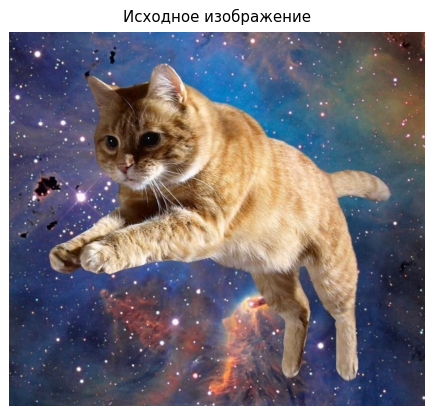

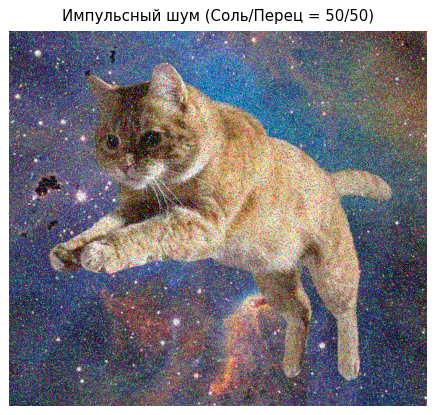

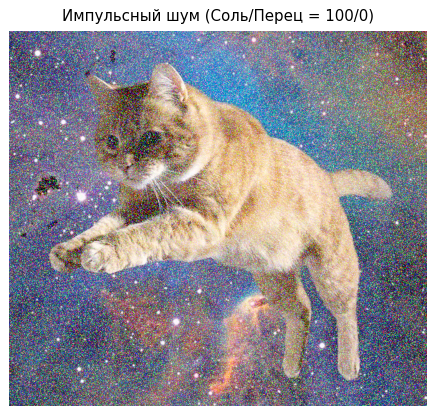

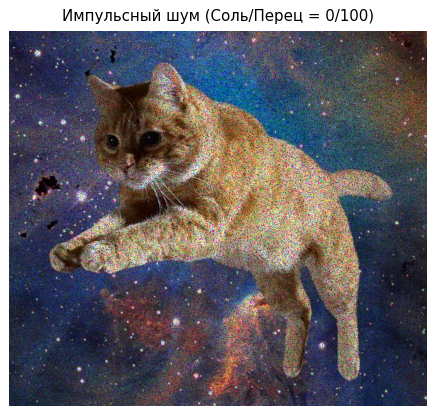

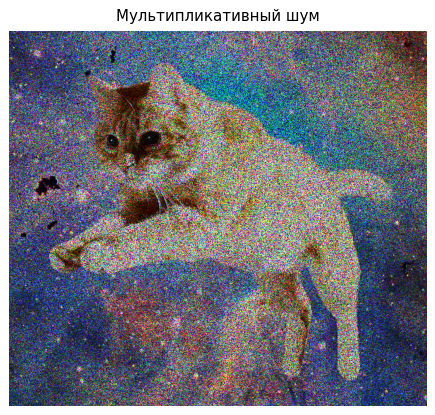

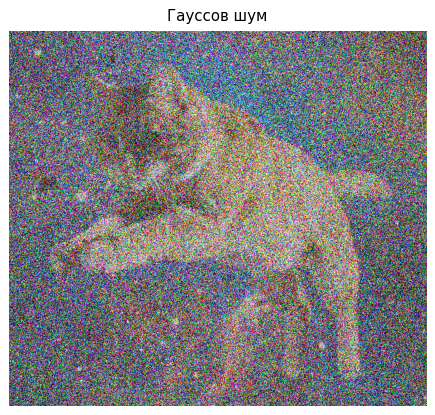

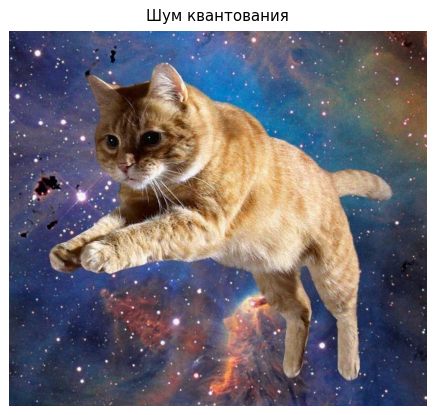

In [9]:
show(images=list(imgs.values()), labels=list(imgs.keys()))

## Низкочастотная фильтрация

Обработать полученные в предыдущем пункте искаженные изображения фильтром Гаусса и контргармоническим усредняющим фильтром с различными значениями параметра 𝑄.

In [10]:
class ImageFilter:
    
    def _to_float(self, img):
        if img.dtype != np.float32:
            return img.astype(np.float32) / 255
        return img
    
    def _to_int(self, img):
        if img.dtype != np.uint8:
            return (255 * img).clip(0, 255).astype(np.uint8)
        return img
    
    def _bordered_img(self, img: np.ndarray, top: int = 0,
                       bottom: int = None, left: int = 0, right: int = None) -> np.ndarray:
        if bottom is None:
            bottom = top
        if right is None:
            right = left
        return np.pad(img, ((top, bottom), (left, right), (0, 0)), mode='edge')
    
    def _img_convert(f):
        def wrapper(self, img, *args, **kwargs):
            return self._to_int(f(self, self._to_float(img), *args, **kwargs))
        return wrapper

In [11]:
class ImageLowPassFilter(ImageFilter):
    
    def gaussian(self, img: np.ndarray, kernel: Tuple[int, int] = (5, 5),
                 sigma_x: float = 0, sigma_y: float = 0) -> np.ndarray:
        '''
        Blurs an image using a Gaussian filter, that is highly
        effective in removing Gaussian noise from an image.

        Parameters
        ----------
        img : ndarray
            Input noisy image.
        kernel : tuple of two ints
            Width and height can differ but they both must be positive and odd.
            Or, they can be zero's and then they are computed from sigma.
        sigma_x : float
            Gaussian kernel standard deviation in X direction.
        sigma_y : float 
            Gaussian kernel standard deviation in Y direction.
            if sigma_y is zero, it is set to be equal to sigmaX.
            if both sigmas are zeros, they are computed from width and height.

        Returns
        -------
        out_img : ndarray
            Image after applying Gaussian filtering
        '''
        return cv2.GaussianBlur(img, kernel, sigma_x, sigma_y)
    
    @ImageFilter._img_convert
    def counterharmonic_averaging(self, img: np.ndarray,
                                  kernel_size: int = 3, Q: int = 0) -> np.ndarray:
        
        rows, cols = img.shape[:2]

        top = left = mid = kernel_size // 2
        bottom = right = mid + kernel_size % 2
        
        b_img = self._bordered_img(img, top, bottom, left, right)
        new_img = np.zeros_like(b_img, dtype=np.float32)
        
        coef = 1 / kernel_size ** 2
        img_power = [(img + 1e-15)**(Q + 1), (img + 1e-15)**Q]
        
        for x in range(-top, bottom):
            for y in range(-left, right):
                new_img[mid + x:mid + rows + x, mid + y:mid + cols + y] += coef * img_power[0] / img_power[1]

        return new_img[top:-bottom, left:-right]

In [12]:
imf = ImageLowPassFilter()
imgs = {
    'Исходное изображение': it.img,
    'Импульсный шум (Соль/Перец = 50/50)': it.impulse(d=0.2, s_vs_p=0.5),
    'Импульсный шум (Соль/Перец = 100/0)': it.impulse(d=0.2, s_vs_p=1),
    'Импульсный шум (Соль/Перец = 0/100)': it.impulse(d=0.2, s_vs_p=0),
    'Мультипликативный шум': it.multiplicative(var=2),
    'Гауссов шум': it.gaussian(mean=0, var=1),
    'Шум квантования': it.quantization(),
}

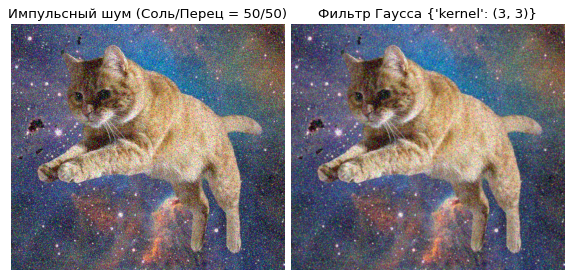

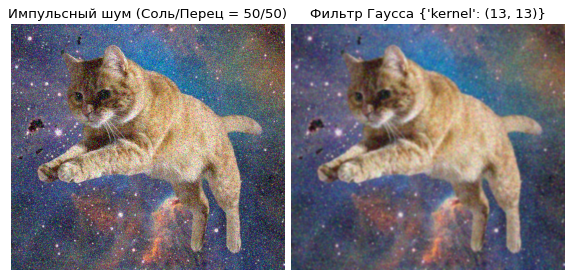

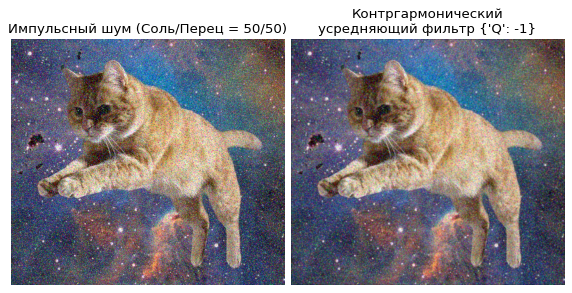

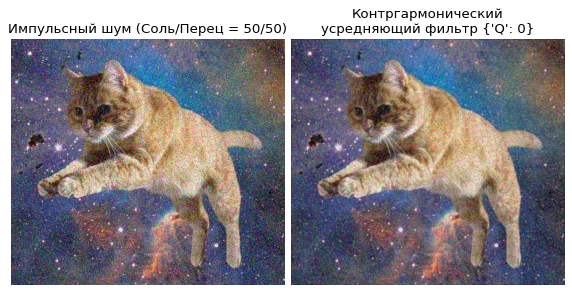

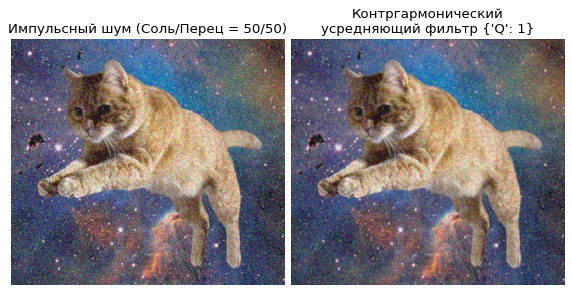

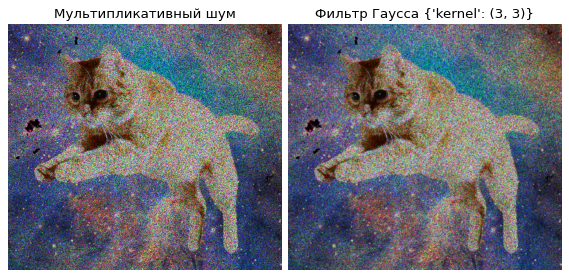

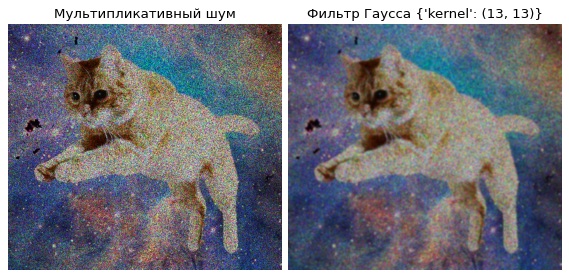

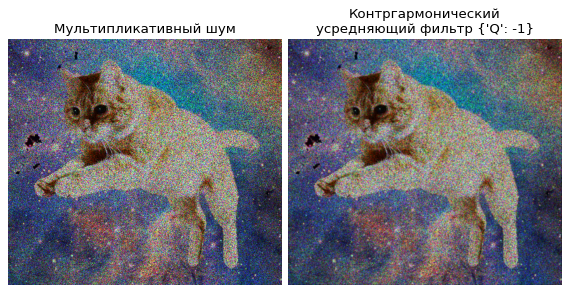

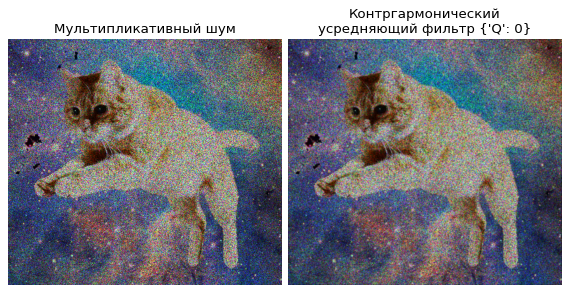

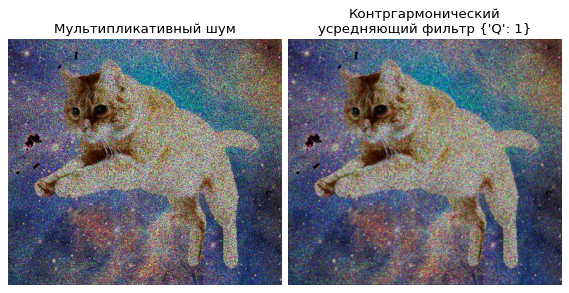

In [13]:
except_images = [
    'Исходное изображение',
    'Импульсный шум (Соль/Перец = 100/0)',
    'Импульсный шум (Соль/Перец = 0/100)',
    'Гауссов шум',
    'Шум квантования',
]

show_filters(
    noisy_imgs=except_keys(imgs, except_images),
    filter_dict={
        'Фильтр Гаусса': {
            'func': imf.gaussian,
            'params': {
                'kernel': [(3, 3), (13, 13)],
            }
        },
        'Контргармонический\nусредняющий фильтр': {
            'func': imf.counterharmonic_averaging,
            'params': {
                'Q': [-1, 0, 1],
            }
        }
    }
)

## Нелинейная фильтрация

Обработать полученные в первом пункте искаженные изображения медианной, взвешенной медианной, ранговой и винеровской фильтрациями при различных размерах маски и ее коэффициентов.

In [14]:
class ImageNonlinearFilter(ImageFilter):

    def median(self, img: np.ndarray, ker_size: int = 3) -> np.ndarray:
        '''
        Blurs an image using the median filter.

        Parameters
        ----------
        img : ndarray
            Input noisy image.
        ker_size : int
            Aperture linear size. It must be odd and greater than 1

        Returns
        -------
        out_img : ndarray
            Image after applying median filtering
        '''
        return cv2.medianBlur(img, ker_size)

    def weighted_median(self, img: np.ndarray, ker_size: Tuple[int, int] = (3, 3)) -> np.ndarray:
        if np.prod(ker_size) % 2 == 0:
            raise Exception("The product of ker_size must be odd")
        return self.rank(img, ker_size, rank=(np.prod(ker_size) + 1) // 2)

    @ImageFilter._img_convert
    def rank(self, img: np.ndarray, ker_size=(3, 3),
             rank: int = 0) -> np.ndarray:

        if img.ndim == 2:
            raise NotImplementedError

        rows, cols = img.shape[0:2]
        b_img = self._bordered_img(img,
                                   top=(ker_size[0] - 1) // 2,
                                   left=(ker_size[1] - 1) // 2)
        layers = np.zeros((*img.shape, np.prod(ker_size)))

        for x in range(ker_size[0]):
            for y in range(ker_size[1]):
                layers[..., x*ker_size[1] + y] = b_img[x:x + rows, y:y + cols]
        
        return np.sort(layers)[..., rank]

    @ImageFilter._img_convert
    def wiener(self, img: np.ndarray, ker_size=(5, 5)) -> np.ndarray:

        rows, cols = img.shape[:2]
        kernel = np.ones((ker_size[0], ker_size[1]))

        top = left = int((ker_size[1] - 1) / 2)
        bottom = right = int(ker_size[1] / 2)
        b_img = self._bordered_img(img, top, bottom, left, right)

        layers = cv2.split(b_img)
        new_layers = []
        k_power = kernel**2

        for layer in layers:

            layer_power = layer**2
            mean = np.zeros(img.shape[:2], np.float32)
            var = np.zeros(img.shape[:2], np.float32)

            # Calculate variance values
            for i in range(ker_size[0]):
                for j in range(ker_size[1]):
                    mean += kernel[i, j] * layer[i:i + rows, j:j + cols]
                    var += k_power[i, j] * layer_power[i:i + rows, j:j + cols]

            mean = mean / np.sum(kernel)
            var = var / np.sum(kernel) - mean * mean
            noise_var = np.sum(var) / img.size  # Noise as an average variance

            # Do filter
            height, width = map(lambda x: (x - 1) // 2, ker_size)
            new_layer = layer[height:height + rows, width:width + cols]
            new_layer = np.where(
                var < noise_var, mean, (new_layer - mean) * (1 - noise_var / (var + 1e-15)) + mean)
            new_layers.append(new_layer)

        return cv2.merge(new_layers)

In [15]:
imf = ImageNonlinearFilter()

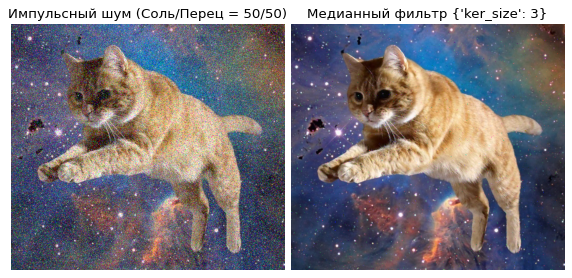

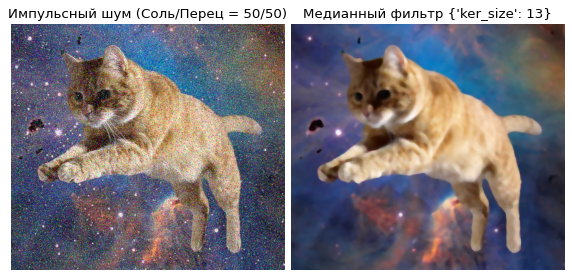

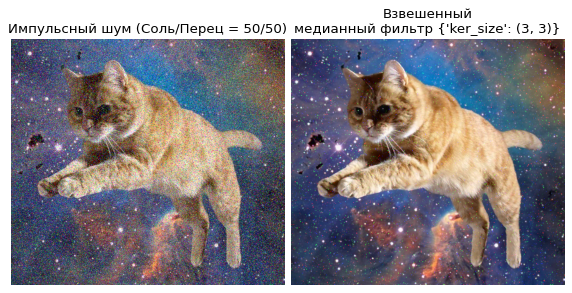

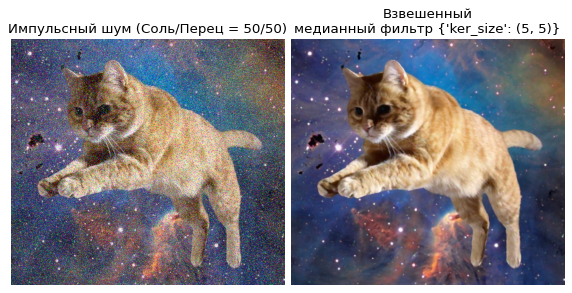

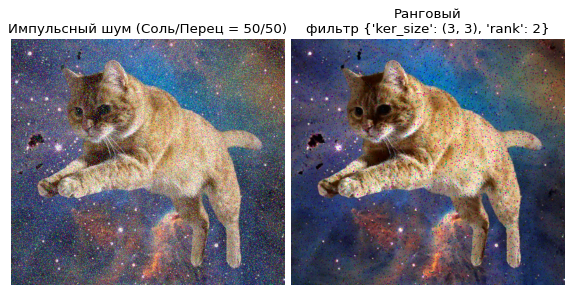

...

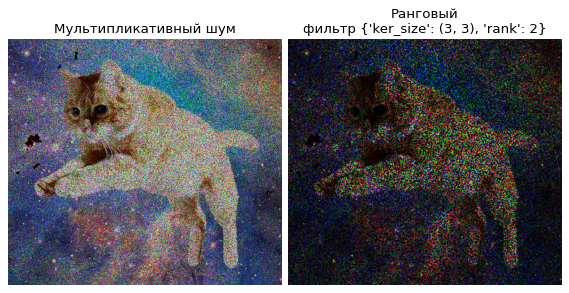

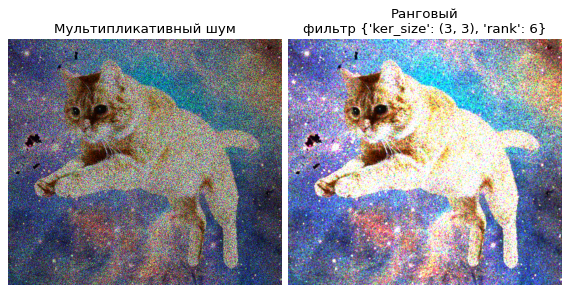

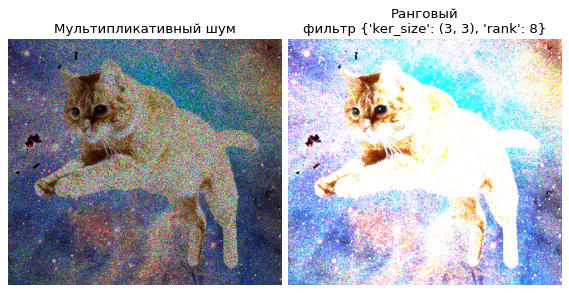

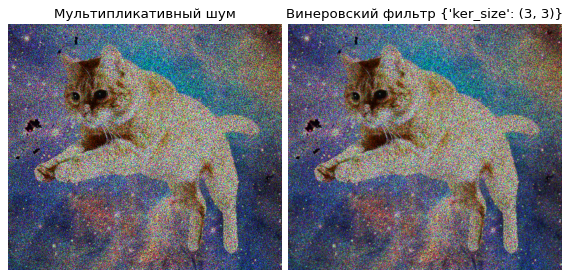

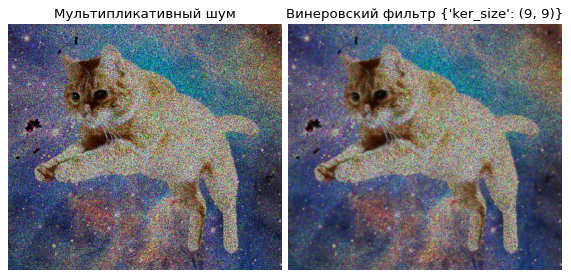

In [16]:
show_filters(
    noisy_imgs=except_keys(imgs, except_images),
    filter_dict={
        'Медианный фильтр': {
            'func': imf.median,
            'params': {
                'ker_size': [3, 13],
            }
        },
        'Взвешенный\nмедианный фильтр': {
            'func': imf.weighted_median,
            'params': {
                'ker_size': [(3, 3), (5, 5)],
            }
        },
        'Ранговый\nфильтр': {
            'func': imf.rank,
            'params': {
                'ker_size': [(3, 3)],
                'rank': [2, 6, 8],
            }
        },
       'Винеровский фильтр': {
            'func': imf.wiener,
            'params': {
                'ker_size': [(3, 3), (9, 9)],
            }
        },
    }
)

## Высокочастотная фильтрация

Выбрать исходное изображение. Выделить границы фильтрами Робертса, Превитта, Собела, Лапласа, алгоритмом Кэнни.

In [17]:
class ImageHighPassFilter(ImageFilter):

    @ImageFilter._img_convert
    def _common(self, img, Gx, Gy):
        return cv2.magnitude(x=cv2.filter2D(img, -1, np.array(Gx)),
                             y=cv2.filter2D(img, -1, np.array(Gy)))

    def roberts(self, img: np.ndarray) -> np.ndarray:
        return self._common(img, [[1, -1], [0, 0]], [[1, 0], [-1, 0]])

    def prewitt(self, img: np.ndarray) -> np.ndarray:
        return self._common(img, [[-1, 0, 1]] * 3, np.array([[-1, 0, 1]] * 3).T)

    @ImageFilter._img_convert
    def sobel(self, img: np.ndarray, dx: int, dy: int) -> np.ndarray:
        return cv2.Sobel(img, -1, dx, dy)

    def laplace(self, img: np.ndarray) -> np.ndarray:
        return cv2.Laplacian(img, -1)

    def canny(self, img: np.ndarray, threshold1: float, threshold2: float) -> np.ndarray:
        return self._to_int(cv2.Canny(img, threshold1, threshold2))

In [18]:
imf = ImageHighPassFilter()

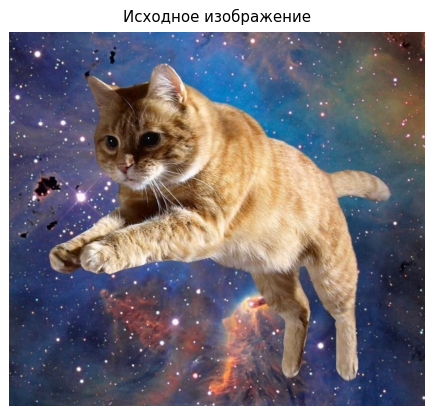

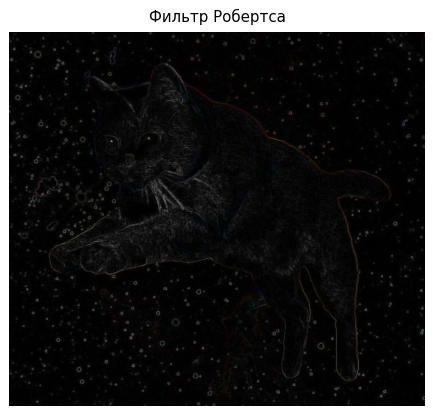

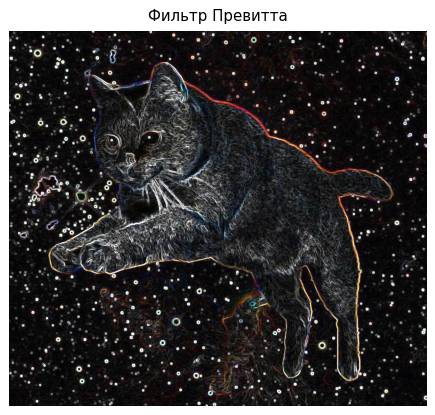

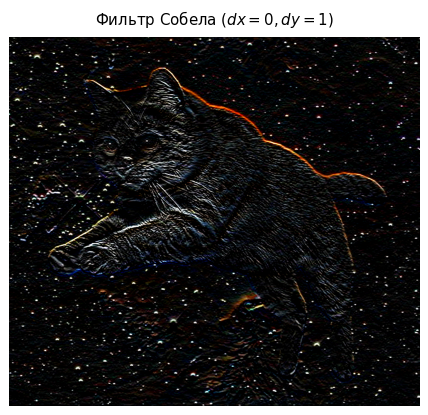

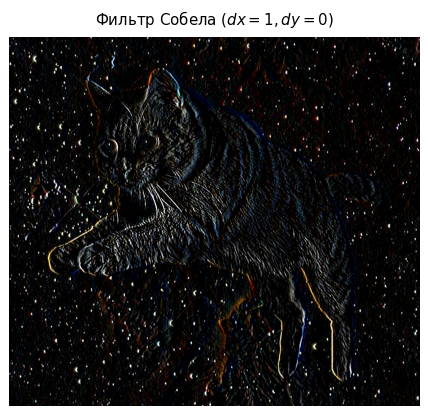

...

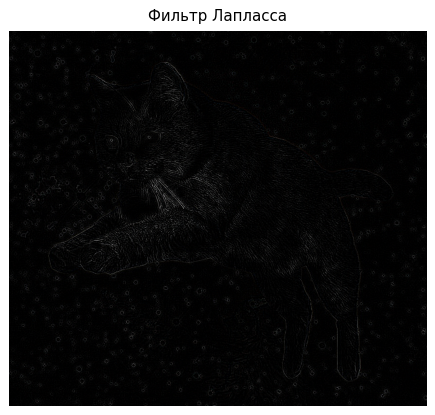

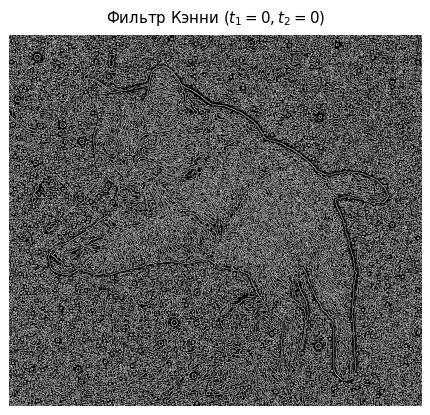

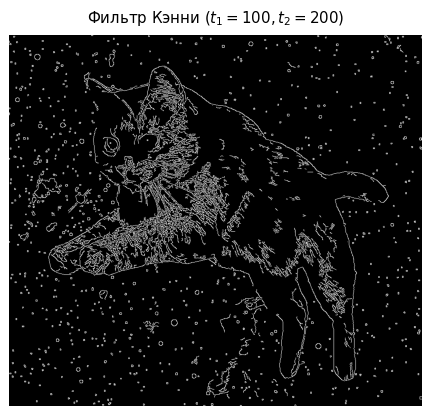

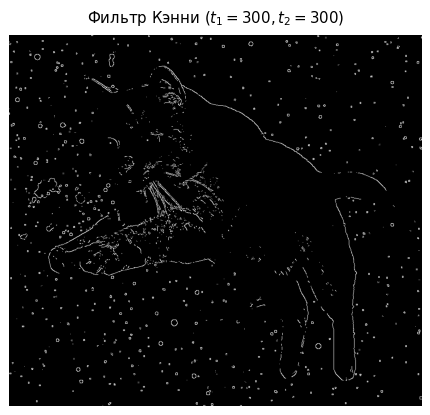

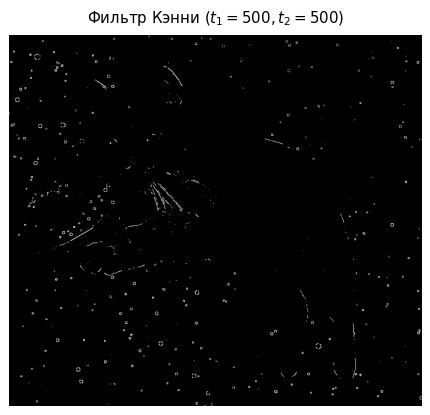

In [19]:
show(
    images=[
        imgs['Исходное изображение'],
        imf.roberts(imgs['Исходное изображение']),
        imf.prewitt(imgs['Исходное изображение']),
        imf.sobel(imgs['Исходное изображение'], dx=0, dy=1),
        imf.sobel(imgs['Исходное изображение'], dx=1, dy=0),
        imf.sobel(imgs['Исходное изображение'], dx=1, dy=1),
        imf.laplace(imgs['Исходное изображение']),
        imf.canny(imgs['Исходное изображение'], threshold1=0, threshold2=0),
        imf.canny(imgs['Исходное изображение'], threshold1=100, threshold2=200),
        imf.canny(imgs['Исходное изображение'], threshold1=300, threshold2=300),
        imf.canny(imgs['Исходное изображение'], threshold1=500, threshold2=500),
    ],
    labels=[
        'Исходное изображение',
        'Фильтр Робертса',
        'Фильтр Превитта',
        'Фильтр Собела $(dx=0, dy=1)$',
        'Фильтр Собела $(dx=1, dy=0)$',
        'Фильтр Собела $(dx=1, dy=1)$',
        'Фильтр Лапласса',
        'Фильтр Кэнни $(t_1=0, t_2=0)$',
        'Фильтр Кэнни $(t_1=100, t_2=200)$',
        'Фильтр Кэнни $(t_1=300, t_2=300)$',
        'Фильтр Кэнни $(t_1=500, t_2=500)$',
    ]
)

# Дополнительные источники:

* [Filtering tutorial](https://docs.opencv.org/4.x/d4/d13/tutorial_py_filtering.html)